In [77]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import statsmodels.stats.diagnostic
from sklearn import svm, linear_model
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from pyecharts import options as opts
from pyecharts.charts import Scatter3D
import random

# import data from CSV file

In [78]:
df = pd.read_csv('CpmDataExport_DeviceNumber_17_RAWMergeTime_2019-09-23_03_14_36.CSV', sep=',',skiprows=10)

In [79]:
columns = [column for column in df]
columns

['Time',
 'L1',
 'L2',
 'L3',
 'Environment',
 'OutgoingL1_1',
 'OutgoingL2_1',
 'OutgoingL3_1',
 'OutgoingL1_2',
 'OutgoingL2_2',
 'OutgoingL3_2']

In [80]:
EnvironmentDataList = df.Environment.value_counts()
EnvironmentDataList

43.0    150
42.0    143
44.0    115
45.0     79
46.0     65
47.0     59
48.0     42
49.0     17
Name: Environment, dtype: int64

In [81]:
df.head(10)

,Time,L1,L2,L3,Environment,OutgoingL1_1,OutgoingL2_1,OutgoingL3_1,OutgoingL1_2,OutgoingL2_2,OutgoingL3_2
0,2019-09-15 23-53-10,0.9575,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN
1,2019-09-15 23-53-12,NaN,0.0,0.0,NaN,NaN,38.0,NaN,38.0,NaN,38.0
2,2019-09-15 23-55-00,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN,NaN,NaN
3,2019-09-15 23-56-10,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN
4,2019-09-16 00-03-10,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,38.0,NaN
5,2019-09-16 00-03-12,0.9575,0.0,0.0,NaN,38.0,38.0,NaN,38.0,NaN,38.0
6,2019-09-16 00-04-50,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN
7,2019-09-16 00-04-52,NaN,NaN,NaN,NaN,NaN,NaN,37.0,NaN,NaN,NaN
8,2019-09-16 00-04-56,NaN,NaN,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN
9,2019-09-16 00-12-08,NaN,NaN,NaN,NaN,38.0,NaN,NaN,NaN,NaN,NaN


# Pre-processing Data

In [82]:
df.fillna(method='bfill',axis=0, inplace = True)

In [83]:
# df.fillna(method='pad',axis=0, inplace = True)
df.dropna(how='any',axis=0,inplace=True)
df = df[df['OutgoingL1_1']<=1000]

In [84]:
df.head(10)

,Time,L1,L2,L3,Environment,OutgoingL1_1,OutgoingL2_1,OutgoingL3_1,OutgoingL1_2,OutgoingL2_2,OutgoingL3_2
0,2019-09-15 23-53-10,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
1,2019-09-15 23-53-12,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
2,2019-09-15 23-55-00,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
3,2019-09-15 23-56-10,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
4,2019-09-16 00-03-10,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
5,2019-09-16 00-03-12,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
6,2019-09-16 00-04-50,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
7,2019-09-16 00-04-52,0.9575,0.0,0.0,47.0,38.0,38.0,37.0,38.0,38.0,38.0
8,2019-09-16 00-04-56,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0
9,2019-09-16 00-12-08,0.9575,0.0,0.0,47.0,38.0,38.0,38.0,38.0,38.0,38.0


# Data Visualization

## 3D

In [85]:
def scatter3d_base(LabelX, LabelY, LabelZ, DataX, DataY, DataZ,len) -> Scatter3D:
    data = [
            [DataX[i], DataY[i], DataZ[i]] for i in range(len)
    ]
    c = (
        Scatter3D()
        .add("Temp", data,
                xaxis3d_opts=opts.Axis3DOpts(name=LabelX, type_="value",min_=38),
                yaxis3d_opts=opts.Axis3DOpts(name=LabelY, type_="value"),
                zaxis3d_opts=opts.Axis3DOpts(name=LabelZ, type_="value")
            )
        .set_global_opts(
            title_opts=opts.TitleOpts("Temp"),
            visualmap_opts=opts.VisualMapOpts(),
        )
    )
    return c

In [86]:
# fig = plt.figure(figsize=(16, 12))
# ax = fig.add_subplot(111, projection='3d')
# ax.scatter(df['L1'],df['Environment'],df['OutgoingL1_1'])
# ax.set_xlabel('L1')
# ax.set_ylabel('Environment')
# ax.set_zlabel('OutgoingL1_1')
# ax.scatter(df['L1'],df['OutgoingL1_1'])
# plt.show()
sca= scatter3d_base("Environment", "Current L1", "Sensor Temperature", df['Environment'].tolist(), df['L1'].tolist(), df['OutgoingL1_1'].tolist(), df.shape[0])
sca.render_notebook()

## 2D

### Display the relation of Current and Sensor Temperature under same Environment

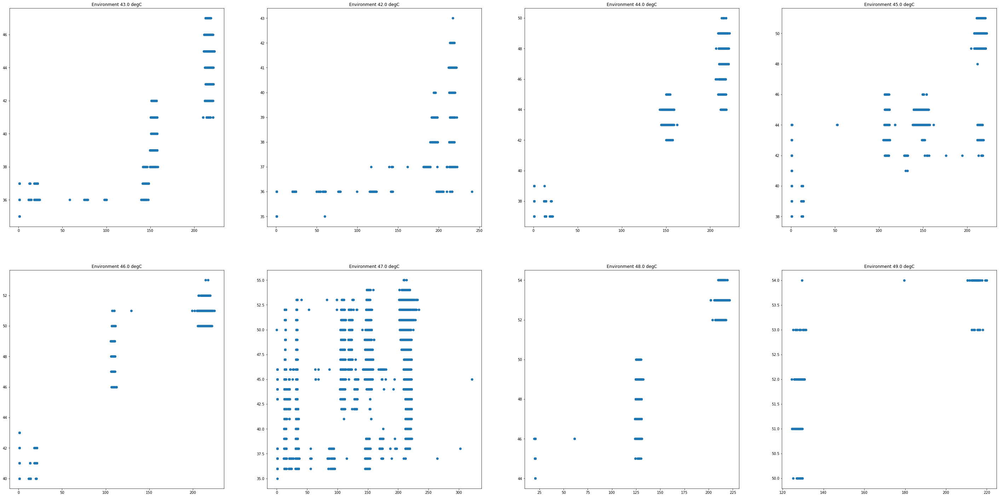

In [87]:
f, ax = plt.subplots(2, 4, figsize = (50, 25))
pltRow=0
pltCol=0
for env in EnvironmentDataList.to_dict().keys():
    dfE = df[["L1", "OutgoingL1_1"]][df.Environment==int(env)]
    ax[pltRow, pltCol].scatter(dfE["L1"], dfE["OutgoingL1_1"])
    ax[pltRow, pltCol].set_title("Environment " + str(env) + " degC")
    if pltCol == 3:
        pltCol = 0
        pltRow += 1
    else:
        pltCol += 1

### L1 - Environment - SensorTemperature

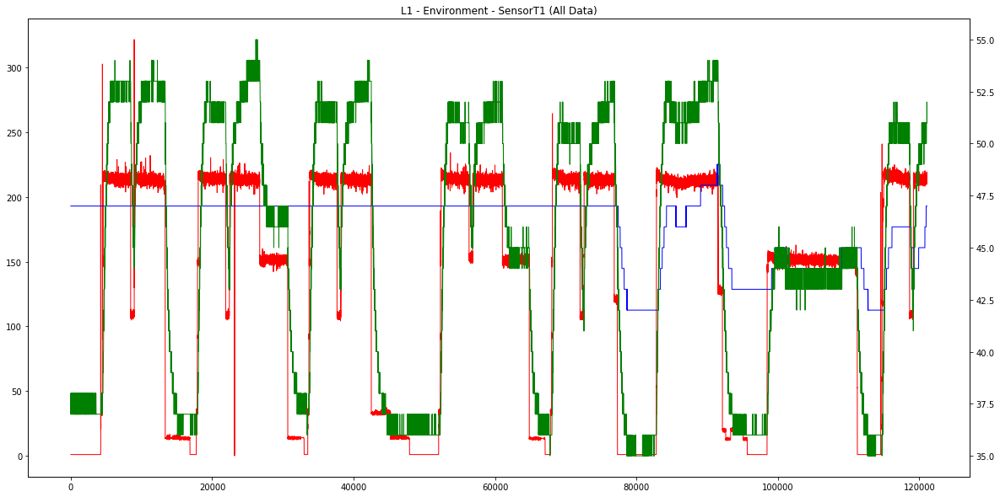

In [88]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(df))]
plt.plot(x, df.L1,color="red", linewidth=1, label = 'L1')
plt.title('L1 - Environment - SensorT1 (All Data)')
plt.twinx()
plt.plot(x, df.Environment, color="blue", linewidth=1, label = 'Environment')
plt.plot(x, df.OutgoingL1_1, color="green", linewidth=1, label = 'T1')

The environment value is not available in the first 80000 points.

In [89]:
dfp = df.tail(40000)

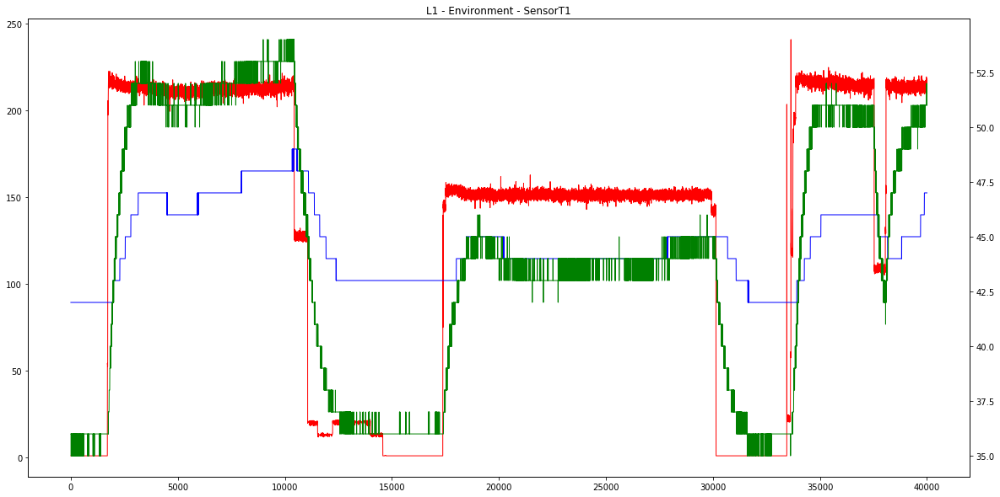

In [90]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(dfp))]
plt.plot(x, dfp.L1,color="red",linewidth=1)
plt.title('L1 - Environment - SensorT1')
plt.twinx()
plt.plot(x, dfp.Environment, color="blue", linewidth = 1)
plt.plot(x, dfp.OutgoingL1_1, color="green", linewidth = 1)

### L2 - Environment - SensorTemperature

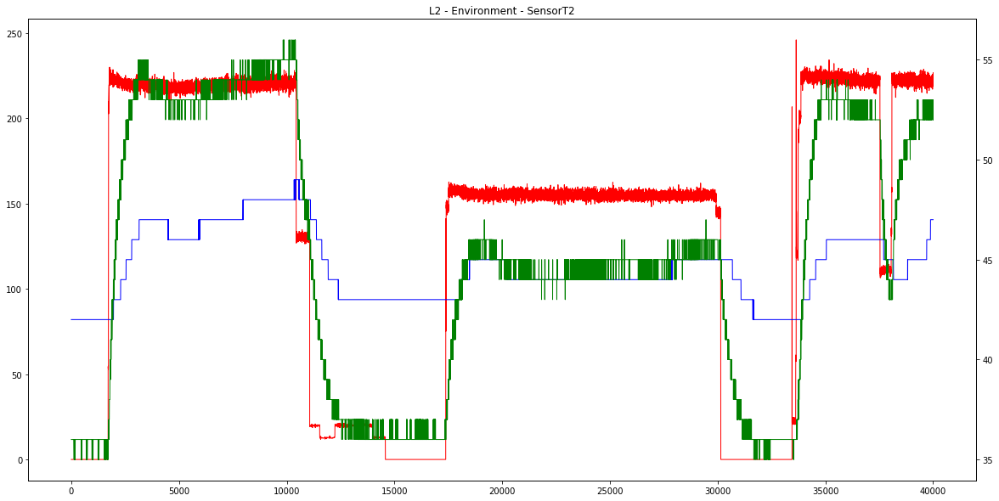

In [91]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(dfp))]
plt.plot(x, dfp.L2,color="red",linewidth=1)
plt.title('L2 - Environment - SensorT2')
plt.twinx()
plt.plot(x, dfp.Environment, color="blue", linewidth = 1)
plt.plot(x, dfp.OutgoingL2_1, color="green", linewidth = 1)

### L3 - Environment - SensorTemperature

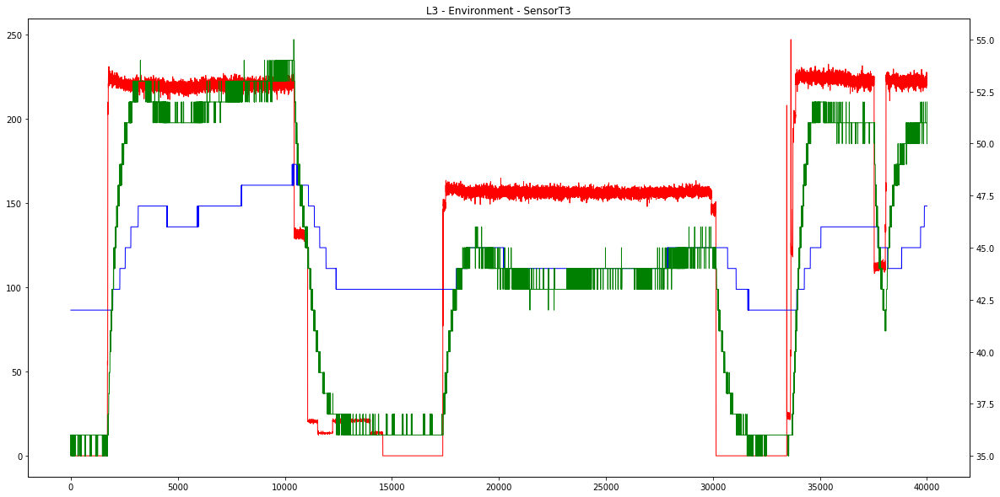

In [92]:
plt.figure(figsize=(20,10))
x = [x for x in range(len(dfp))]
plt.plot(x, dfp.L3,color="red",linewidth=1)
plt.title('L3 - Environment - SensorT3')
plt.twinx()
plt.plot(x, dfp.Environment, color="blue", linewidth = 1)
plt.plot(x, dfp.OutgoingL3_1, color="green", linewidth = 1)

# BBR

## Prepare training data

In [40]:
AllDataCount = len(df)
AllDataCount

TrainingDataSet = df.head(int(AllDataCount*0.7))         #Use first 70% data as training data
TestDataSet = df.tail(int(AllDataCount*0.3))             #Use last 30% data as test data

TrainingDataSet.head(5)
TestDataSet.head(5)

WindowsSize = 10



## Traing model

In [290]:


# Ridge_X_Train = [TrainingDataSet.Environment[i],TrainingDataSet.L1[i], TrainingDataSet.L2[i], TrainingDataSet.L3[i]] for i in range(len(TrainingDataSet))
# Ridge_Y_Train = [TrainingDataSet.OutgoingL1_1[i], TrainingDataSet.OutgoingL2_1[i], TrainingDataSet.OutgoingL3_1[i]] for i in range(len(TrainingDataSet))
TrainingDataSet.head(10)
Ridge_X_Train = [[TrainingDataSet.Environment[i], TrainingDataSet.L1[i], TrainingDataSet.L2[i], TrainingDataSet.L3[i]] for i in range(len(TrainingDataSet))]

print(Ridge_X_Train)
# Ridge_Y_Train.head()

# clf = linear_model.RidgeCV(fit_intercept=False)
# clf.fit(Ridge_X_Train, Ridge_Y_Train)

KeyError: 23157

# VAR